In [2]:

import matplotlib.pyplot as plt
import numpy as np
import PIL
import tensorflow as tf
import pathlib

from tensorflow import keras
from tensorflow.keras import layers
from tensorflow.keras.models import Sequential

In [3]:
data_dir = pathlib.Path('C:/Users/luisa/Desktop/tensorflow-for-poets-2/tensorflow-for-poets-2/tf_files')


In [4]:
image_count = len(list(data_dir.glob('*/*.jpg')))
print(image_count)

5964


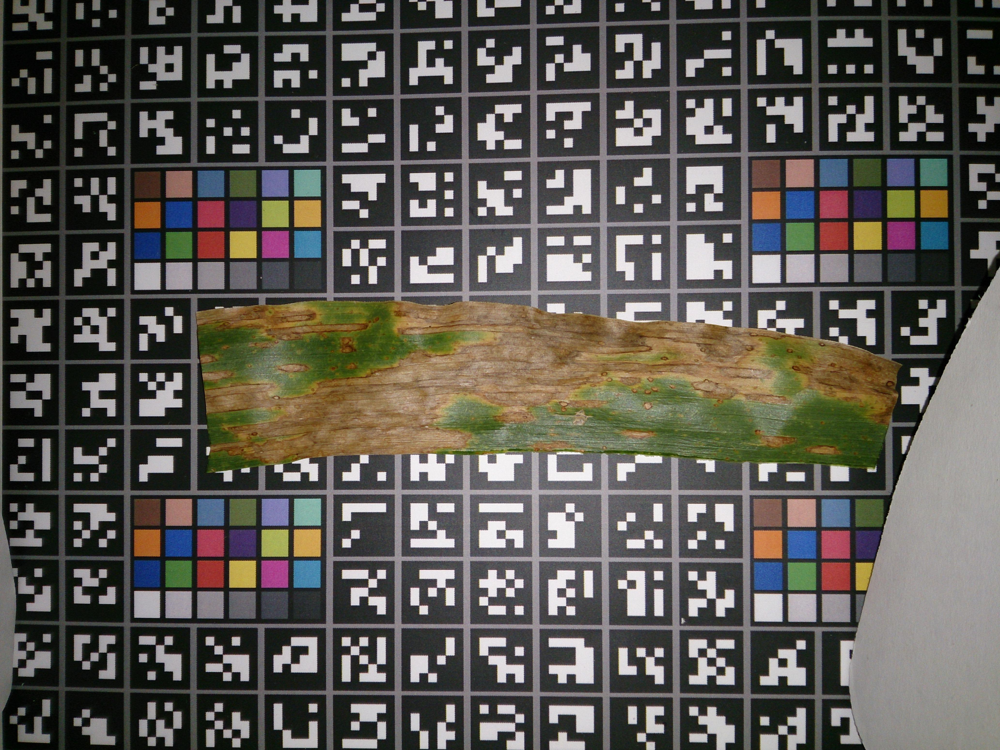

In [5]:
bipolaris_maydis = list(data_dir.glob('bipolaris_maydis/*'))
PIL.Image.open(str(bipolaris_maydis[0]))

In [6]:
batch_size = 32
img_height = 180
img_width = 180

In [7]:
train_ds = tf.keras.utils.image_dataset_from_directory(
  data_dir,
  validation_split=0.2,
  subset="training",
  seed=123,
  image_size=(img_height, img_width),
  batch_size=batch_size)

Found 5976 files belonging to 23 classes.
Using 4781 files for training.


In [8]:
val_ds = tf.keras.utils.image_dataset_from_directory(
  data_dir,
  validation_split=0.2,
  subset="validation",
  seed=123,
  image_size=(img_height, img_width),
  batch_size=batch_size)

Found 5976 files belonging to 23 classes.
Using 1195 files for validation.


In [9]:
class_names = train_ds.class_names
print(class_names)

['bipolaris_maydis', 'cercospora_kikuchii', 'colletotrichum_dematium', 'colletotrichum_graminicola', 'corynespora_cassicola', 'diplodia_macrospora', 'downy_mildew', 'erysiphe_diffusa', 'exserohilum_turcicum', 'fitotoxicidade_do_cobre', 'maize_bushy', 'mildew_rust', 'myrothecium_roridum', 'phaeosphaeria_maydis', 'phakopsora_pachyrhizi', 'phialophora_gregata', 'physarum_sp', 'physoderma_brown', 'physopella_zeae', 'phytophthora_sojae', 'pseudomonas_savastanoi', 'puccinia_polysora', 'septoria_glycines']


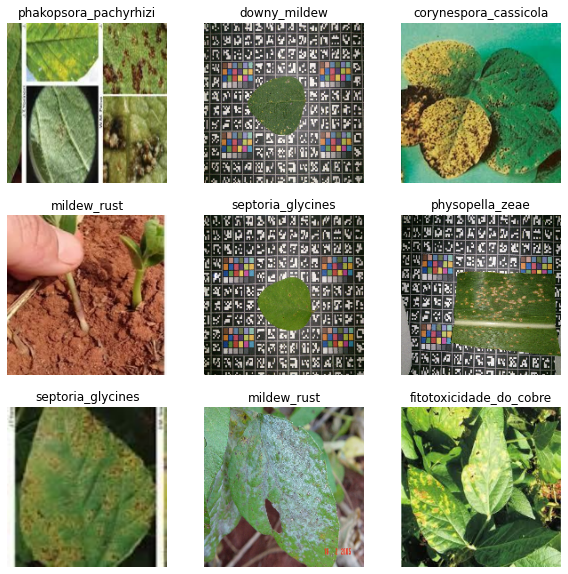

In [10]:
import matplotlib.pyplot as plt

plt.figure(figsize=(10, 10))
for images, labels in train_ds.take(1):
  for i in range(9):
    ax = plt.subplot(3, 3, i + 1)
    plt.imshow(images[i].numpy().astype("uint8"))
    plt.title(class_names[labels[i]])
    plt.axis("off")

In [11]:
for image_batch, labels_batch in train_ds:
  print(image_batch.shape)
  print(labels_batch.shape)
  break

(32, 180, 180, 3)
(32,)


In [12]:
AUTOTUNE = tf.data.AUTOTUNE

train_ds = train_ds.cache().shuffle(1000).prefetch(buffer_size=AUTOTUNE)
val_ds = val_ds.cache().prefetch(buffer_size=AUTOTUNE)

In [13]:
normalization_layer = layers.Rescaling(1./255)

In [14]:
normalized_ds = train_ds.map(lambda x, y: (normalization_layer(x), y))
image_batch, labels_batch = next(iter(normalized_ds))
first_image = image_batch[0]
# Notice the pixel values are now in `[0,1]`.
print(np.min(first_image), np.max(first_image))

0.0 1.0


In [15]:
data_augmentation = keras.Sequential(
  [
    layers.RandomFlip("horizontal",
                      input_shape=(img_height,
                                  img_width,
                                  3)),
    layers.RandomRotation(0.1),
    layers.RandomZoom(0.1),
  ]
)

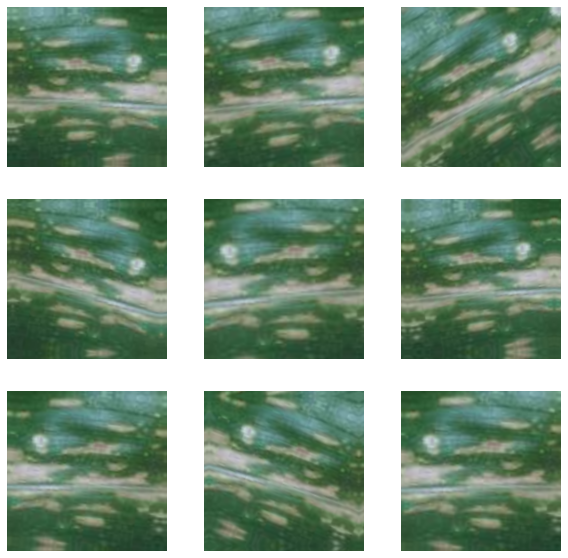

In [16]:
plt.figure(figsize=(10, 10))
for images, _ in train_ds.take(1):
  for i in range(9):
    augmented_images = data_augmentation(images)
    ax = plt.subplot(3, 3, i + 1)
    plt.imshow(augmented_images[0].numpy().astype("uint8"))
    plt.axis("off")

In [17]:
num_classes = len(class_names)

model = Sequential([
  data_augmentation,
  layers.Rescaling(1./255),
  layers.Conv2D(16, 3, padding='same', activation='relu'),
  layers.MaxPooling2D(),
  layers.Conv2D(32, 3, padding='same', activation='relu'),
  layers.MaxPooling2D(),
  layers.Conv2D(64, 3, padding='same', activation='relu'),
  layers.MaxPooling2D(),
  layers.Dropout(0.2),
  layers.Flatten(),
  layers.Dense(128, activation='relu'),
  layers.Dense(num_classes, name="outputs")
])

In [18]:
model.compile(optimizer='adam',
              loss=tf.keras.losses.SparseCategoricalCrossentropy(from_logits=True),
              metrics=['accuracy'])

In [19]:
model.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 sequential (Sequential)     (None, 180, 180, 3)       0         
                                                                 
 rescaling_1 (Rescaling)     (None, 180, 180, 3)       0         
                                                                 
 conv2d (Conv2D)             (None, 180, 180, 16)      448       
                                                                 
 max_pooling2d (MaxPooling2D  (None, 90, 90, 16)       0         
 )                                                               
                                                                 
 conv2d_1 (Conv2D)           (None, 90, 90, 32)        4640      
                                                                 
 max_pooling2d_1 (MaxPooling  (None, 45, 45, 32)       0         
 2D)                                                  

In [20]:
epochs=50
history = model.fit(
  train_ds,
  validation_data=val_ds,
  epochs=epochs
)

Epoch 1/50
150/150 [==============================] - 69s 457ms/step - loss: 2.7169 - accuracy: 0.1889 - val_loss: 2.6260 - val_accuracy: 0.2017
Epoch 2/50
150/150 [==============================] - 59s 396ms/step - loss: 2.4520 - accuracy: 0.2642 - val_loss: 2.6040 - val_accuracy: 0.2351
Epoch 3/50
150/150 [==============================] - 61s 404ms/step - loss: 2.2069 - accuracy: 0.3434 - val_loss: 2.2885 - val_accuracy: 0.3197
Epoch 4/50
150/150 [==============================] - 52s 344ms/step - loss: 2.0481 - accuracy: 0.3815 - val_loss: 2.0873 - val_accuracy: 0.3615
Epoch 5/50
150/150 [==============================] - 60s 397ms/step - loss: 1.9179 - accuracy: 0.4181 - val_loss: 2.2182 - val_accuracy: 0.3356
Epoch 6/50
150/150 [==============================] - 60s 401ms/step - loss: 1.8303 - accuracy: 0.4409 - val_loss: 2.0757 - val_accuracy: 0.4067
Epoch 7/50
150/150 [==============================] - 61s 405ms/step - loss: 1.7342 - accuracy: 0.4698 - val_loss: 2.0060 - val_ac

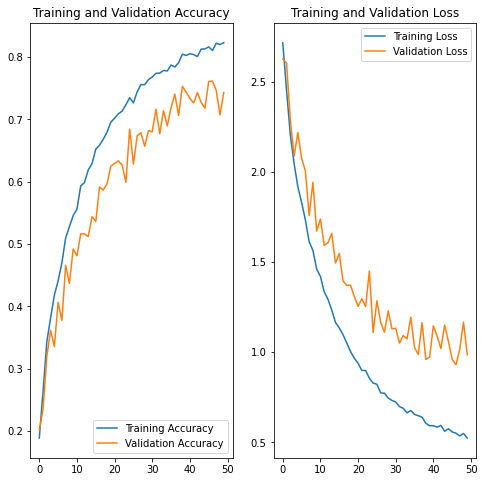

In [21]:
acc = history.history['accuracy']
val_acc = history.history['val_accuracy']

loss = history.history['loss']
val_loss = history.history['val_loss']

epochs_range = range(epochs)

plt.figure(figsize=(8, 8))
plt.subplot(1, 2, 1)
plt.plot(epochs_range, acc, label='Training Accuracy')
plt.plot(epochs_range, val_acc, label='Validation Accuracy')
plt.legend(loc='lower right')
plt.title('Training and Validation Accuracy')

plt.subplot(1, 2, 2)
plt.plot(epochs_range, loss, label='Training Loss')
plt.plot(epochs_range, val_loss, label='Validation Loss')
plt.legend(loc='upper right')
plt.title('Training and Validation Loss')
plt.show()

In [25]:
#sunflower_path = "C:/Users/luisa/Desktop/tensorflow-for-poets-2/imagem_previsao/46546546.jpg"
sunflower_path = "C:/Users/luisa/Desktop/tensorflow-for-poets-2/imagem_previsao/1494464772.jpg"


img = tf.keras.utils.load_img(
    sunflower_path, target_size=(img_height, img_width)
)
img_array = tf.keras.utils.img_to_array(img)
img_array = tf.expand_dims(img_array, 0) # Create a batch

predictions = model.predict(img_array)
score = tf.nn.softmax(predictions[0])

print(
    "This image most likely belongs to {} with a {:.2f} percent confidence."
    .format(class_names[np.argmax(score)], 100 * np.max(score))
)

1/1 [==============================] - 0s 20ms/step
This image most likely belongs to erysiphe_diffusa with a 49.90 percent confidence.


In [24]:
import tensorflow as tf

# Diretório onde o modelo treinado será salvo
model_dir = "modelo"

# Salva o modelo
#tf.saved_model.save(model, model_dir)
model.save("modelo74.h5")

In [43]:
tensorflowjs_converter --input_format=keras "modelo85.h5" ./

SyntaxError: cannot assign to expression here. Maybe you meant '==' instead of '='? (Temp/ipykernel_19856/2810183912.py, line 1)

In [44]:
model.save('./BB_Brasil_Modelo/modelo2')

INFO:tensorflow:Assets written to: ./BB_Brasil_Modelo/modelo2\assets


INFO:tensorflow:Assets written to: ./BB_Brasil_Modelo/modelo2\assets


In [46]:
!tensorflowjs_converter --input_format=tf_saved_model \
                       --output_node_names='MobilenetV3/Predictions/Reshape_1' \
                       --saved_model_tags=serve \
                       ./BB_Brasil_Modelo/modelo2 \
                       ./BB_Brasil_Modelo/modelo2/modelo_convertido


Writing weight file ./BB_Brasil_Modelo/modelo2/modelo_convertido\model.json...


2023-04-14 00:48:08.442227: W tensorflow/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'cudart64_110.dll'; dlerror: cudart64_110.dll not found
2023-04-14 00:48:11.051738: E tensorflow/stream_executor/cuda/cuda_driver.cc:271] failed call to cuInit: CUDA_ERROR_NO_DEVICE: no CUDA-capable device is detected
